In [1]:
#librerias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#import seaborn as sns
import warnings
import cv2 as cv 
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
import numpy as np
from matplotlib import pyplot as plt
def plotear2(img,imgGray):
    fig = plt.figure(figsize=(9, 5))
    fig.add_subplot(1,2,1)
    plt.imshow(img,cmap='gray')
    plt.axis('off')
    plt.title("imagen original")
    fig.add_subplot(1,2,2)
    plt.imshow(imgGray,cmap='gray')
    plt.axis('off')
    plt.title("imagen filtrada")
    plt.show()

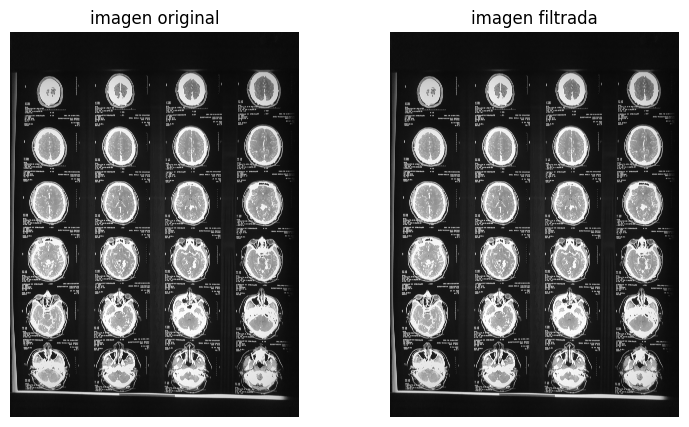

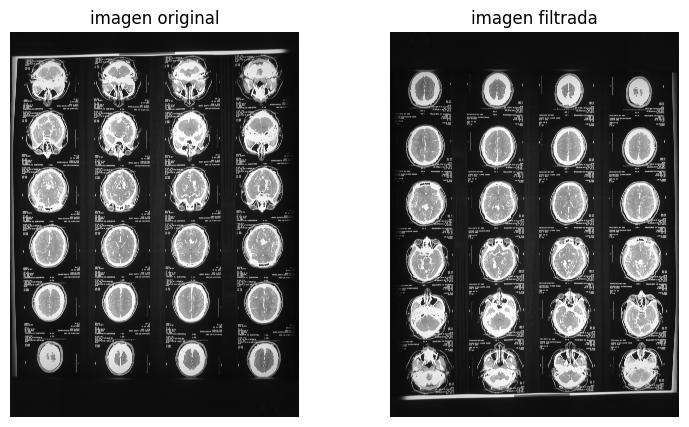

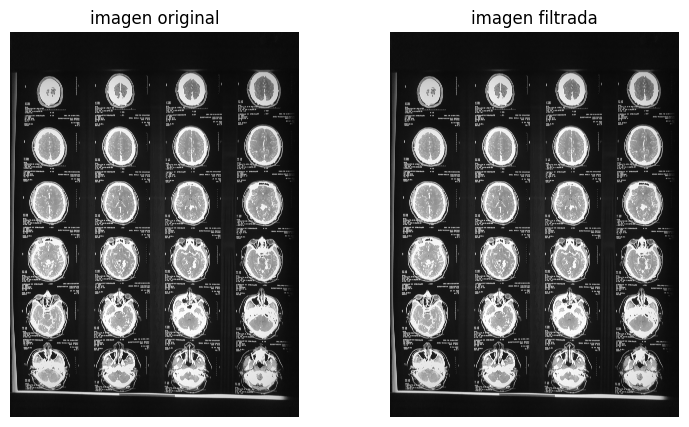

In [3]:
#img = cv.imread(r'C:\Users\Vostro\Downloads\IMG_20221026_142719.jpg',0)
img = cv.imread(r"E:\Septimo semestre\Procesamiento de imagenes\cerebros.jpg",0)
plotear2(img,img)
flipVertical = cv.flip(img, 0)
flipHorizontal = cv.flip(img, 1)
plotear2(flipVertical,flipHorizontal)
flipVertical2 = cv.flip(flipVertical, 0)
flipHorizontal2 = cv.flip(flipHorizontal, 1)
plotear2(flipVertical2,flipHorizontal2)

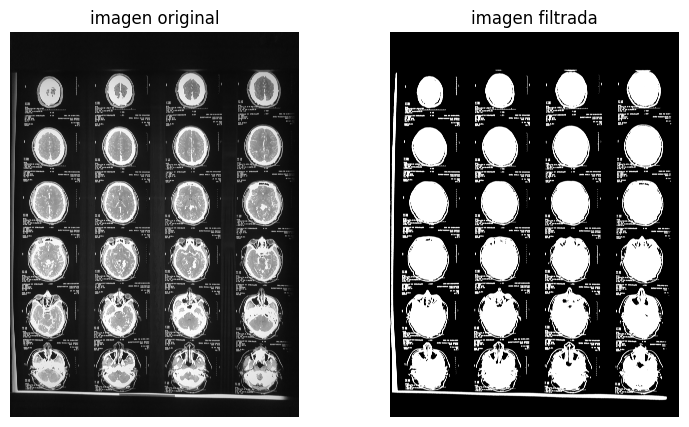

In [66]:
#img = cv.imread(r'C:\Users\Vostro\Downloads\IMG_20221026_142719.jpg',0)
img = cv.imread(r"E:\Septimo semestre\Procesamiento de imagenes\cerebros.jpg",0)
#plotear2(flipVertical,flipHorizontal)
img = cv.medianBlur(img,5)
#imgr = cv.flip(img, 1)
ret,th1 = cv.threshold(img,60,90,cv.THRESH_BINARY)
plotear2(img,th1)

In [6]:
#filtramos por tamaño
nb_components, output, stats, centroids = cv.connectedComponentsWithStats(th1, connectivity=8)

sizes = stats[1:, -1]; nb_components = nb_components - 1

min_size = 100000 # Este tamaño es variable, yo he puesto 1000 
max_size = 700000 
img2 = np.zeros((output.shape))

for i in range(0, nb_components):
    if max_size >= sizes[i] >= min_size :
        img2[output == i + 1] = 255

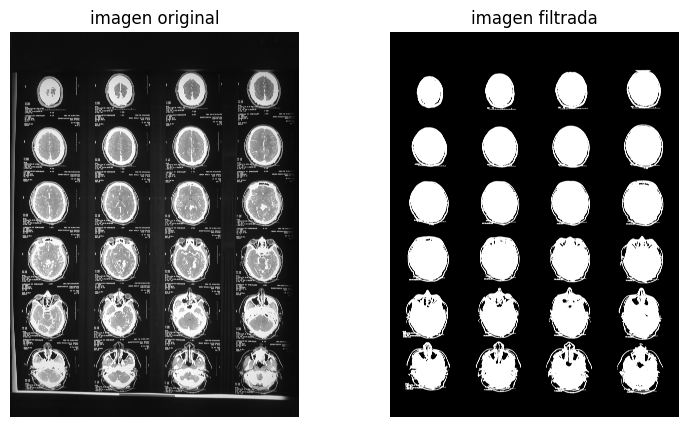

In [7]:
plotear2(img,img2)

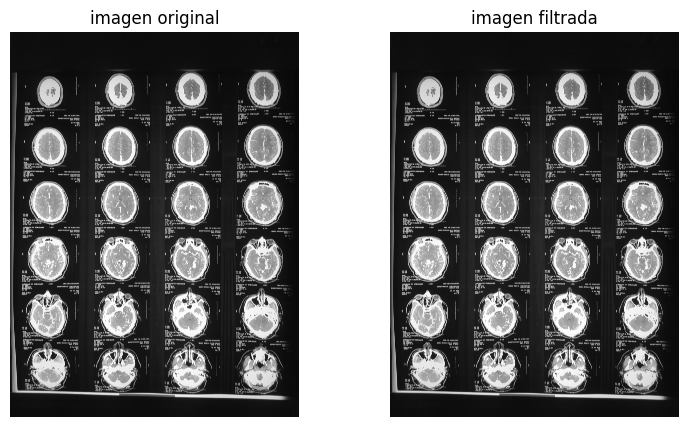

In [65]:
#detectar limites de la imagen 
#convert to np.uint8
img2 = np.uint8(img2)
#find contours
contours, hierarchy = cv.findContours(img2, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
#draw contours
cnt = contours[0]
x,y,w,h = cv.boundingRect(cnt)
img3 = img2[y:y+h, x:x+w]
plotear2(img2,img3)



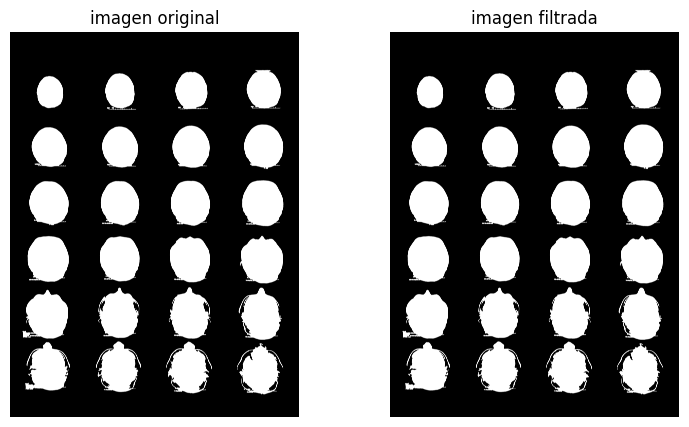

In [8]:
def rellenar(Img,It):
    for i in range(0,It):
        ImFlood  = np.uint8(Img.copy())
        h,w = Img.shape[:2]
        img2 = np.uint8(Img)
        mask = np.zeros((h+2,w+2),np.uint8)
        cv.floodFill(ImFlood,mask,(0,0),255)

        ImFloodInv = cv.bitwise_not(ImFlood)

        ImgOut = img2| ImFloodInv
        Img = ImgOut
    return ImgOut

img4 = rellenar(img2,1)
img5 = rellenar(img2,3)
#plotear2(img,img2)
plotear2(img4,img5)
#plotear2(img3,img4)

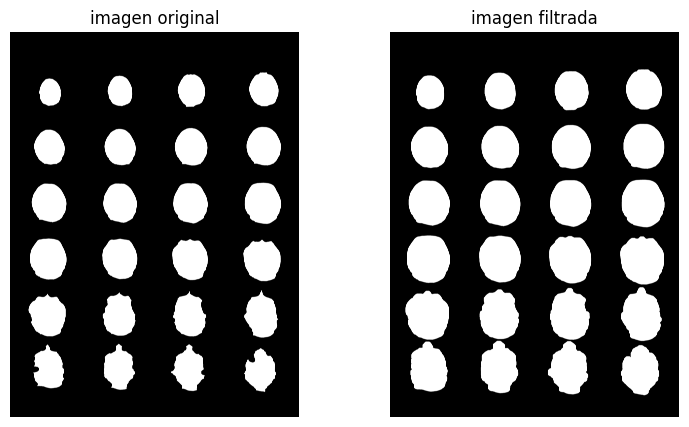

In [9]:
#operaciones morfologicas 
#dilate 
#kernel = np.ones((5,5),np.uint8)
kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(20,20))
img6 = cv.erode(img5,kernel,iterations = 5)
img7 = cv.dilate(img6,kernel,iterations = 7)#img6 = cv.morphologyEx(img5, cv.MORPH_CLOSE, kernel)
plotear2(img6,img7)

In [10]:
import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology
mask = img7
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip') # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(0, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(go.Scatter(
        x=x, y=y, name=label_i,
        mode='lines', fill='toself', showlegend=False,
        hovertemplate=hoverinfo, hoveron='points+fills'))

plotly.io.show(fig)

In [11]:
from skimage.measure import label, regionprops, regionprops_table
label_img = label(img7)
regions = regionprops(label_img)
regions_table = regionprops_table(label_img, properties=('label','area','bbox','centroid','convex_area','eccentricity','equivalent_diameter','euler_number','extent','filled_area','major_axis_length','minor_axis_length','orientation','perimeter','solidity'))
df = pd.DataFrame(regions_table)
df

,label,area,bbox-0,bbox-1,bbox-2,bbox-3,centroid-0,centroid-1,convex_area,eccentricity,equivalent_diameter,euler_number,extent,filled_area,major_axis_length,minor_axis_length,orientation,perimeter,solidity
0,1,494019,778,4900,1613,5646,1198.267378,5274.316976,497131,0.474499,793.098056,1,0.793082,494019,845.610569,744.353890,0.170100,2646.851081,0.993740
1,2,455094,816,3418,1628,4124,1218.583932,3769.850596,457958,0.515313,761.211979,1,0.793854,455094,822.776856,705.121388,0.066359,2546.625684,0.993746
2,3,396172,846,1963,1610,2610,1230.042247,2287.338706,398100,0.540636,710.226624,1,0.801468,396172,774.821467,651.823543,0.125804,2372.802307,0.995157
3,4,329506,903,542,1605,1126,1256.848449,833.555064,331438,0.548118,647.719129,1,0.803736,329506,708.748366,592.797744,0.059927,2159.949494,0.994171
4,5,634397,1910,4847,2845,5696,2379.309600,5269.578940,637942,0.437488,898.743204,1,0.799175,634397,948.189617,852.634962,0.124882,2992.272437,0.994443
5,6,590590,1933,3357,2844,4171,2393.932935,3762.808056,594005,0.470855,867.157738,1,0.796422,590590,923.661297,814.863868,0.107897,2893.017603,0.994251
6,7,552173,1951,1898,2840,2684,2399.677858,2289.942074,554651,0.502769,838.479874,1,0.790225,552173,902.238907,779.913921,0.198807,2796.532322,0.995532
7,8,524411,1967,435,2827,1209,2400.043146,822.342174,527091,0.480143,817.129624,1,0.787830,524411,872.798727,765.610523,0.233534,2719.218613,0.994915
8,9,710727,3070,4809,4058,5701,3557.426247,5251.116068,714510,0.465833,951.275839,1,0.806457,710727,1011.820648,895.332278,0.145363,3180.757718,0.994705
9,10,661036,3080,3325,4050,4180,3557.323010,3748.447690,664312,0.497816,917.418757,1,0.797053,661036,985.603776,854.797236,0.141632,3073.100864,0.995069


In [20]:
print(dfCent.index[[0]])
img.shape[0]

Int64Index([0], dtype='int64')


8000

In [12]:
#show centroids in data frame 
dfCent=df.iloc[:,[0,6,7]]
# valor de centriode minimo en x 
centX =df.iloc[:,7]
centY =df.iloc[:,6]
#minCentX = centX.argmin()
minCentX = np.amin(centX)
print("valor minimo:",minCentX)
minS = np.zeros(6)

j = 0
for i in range(0,len(centX)):
    if centX[i] <= minCentX+100 and centX[i] >= minCentX-100 :
        print(centX[i])
        minS[j] =  centX.index[i]
        j = j+1
#minS[7] = img.shape[0]
print(minS)
z = len(minS)
centMinIndex= np.zeros((6,2))
for e in range(0,len(minS)):
    centMinIndex[e,0] =  centY[minS[e]]
    centMinIndex[e,1] = centX[minS[e]]

print(centMinIndex)
#distancias 
minS = np.concatenate(([0],minS,img.shape[0]), axis=None)
print(minS)

valor minimo: 782.1686287353688
833.555064247692
822.342174363238
813.6019028534963
796.4651665153948
782.1686287353688
801.824003891794
[ 3.  7. 11. 12. 19. 22.]
[[1256.84844889  833.55506425]
 [2400.04314555  822.34217436]
 [3553.91933726  813.60190285]
 [4714.48601829  796.46516652]
 [5890.58384277  782.16862874]
 [6996.69053816  801.82400389]]
[0.0e+00 3.0e+00 7.0e+00 1.1e+01 1.2e+01 1.9e+01 2.2e+01 8.0e+03]


In [47]:
dist = np.zeros(len(minS)-1)
for i in range(0,len(minS)-1):
    dist[i] = minS[i+1]-minS[i]
print(dist)
mean = int(np.round(np.mean(dist)))
print(mean)

[3.000e+00 4.000e+00 4.000e+00 1.000e+00 7.000e+00 3.000e+00 7.978e+03]
1143


In [18]:
#recortar imagenes en distancias 
#generar imagenes de base 
imgBase = np.zeros((mean,img.shape[1],z))
imgBase.shape
#vector de promedios


(1143, 6000, 6)

In [59]:
 
maxY = img.shape[0]
vecMean = np.arange(0,maxY,mean)
vecMean = np.concatenate((vecMean,maxY), axis=None)
print(vecMean)
CutCenter = np.zeros(len(vecMean)-1)
for i in range(0,len(vecMean)-1):
    CutCenter[i] = int((vecMean[i]+vecMean[i+1])/2)
    print(CutCenter[i])
    #sum a vule correspondign to 10%
    CutCenter[i] = int(CutCenter[i]+CutCenter[i]*0.05)
print(CutCenter)
CutCenter=CutCenter.astype(int)
print(CutCenter)

[   0 1143 2286 3429 4572 5715 6858 8000]
571.0
1714.0
2857.0
4000.0
5143.0
6286.0
7429.0
[ 57. 171. 285. 400. 514. 628. 742.]
[ 57 171 285 400 514 628 742]


In [58]:
#recortar img 
for i in range(0,len(CutCenter)-1):
    print(CutCenter[i],CutCenter[i+1])
    imgBase[:,:,i] =img7[CutCenter[i]:CutCenter[i+1],:]
    
    #imgBase[:,:,i] = img[vecMean[i]:vecMean[i+1],:]
#plot imgBase
plotear2(imgBase[:,:,0],imgBase[:,:,1])
plotear2(imgBase[:,:,2],imgBase[:,:,3])
plotear2(imgBase[:,:,4],imgBase[:,:,5])

    

599 1799


ValueError: could not broadcast input array from shape (1200,6000) into shape (1143,6000)

In [ ]:
def cortarImagenes(img,regions):


    
    ruta = "E:\Septimo semestre\Servicio\digitalizador\imgCut\Img"
    n = 1
    for props in regions:
        minr, minc, maxr, maxc = props.bbox
        crop_img = img[minr-100:maxr+100, minc-100:maxc+100]
        #crop_img = cv.flip(crop_img, 1)
        cv.imwrite(ruta+str(n)+".jpg",crop_img)
        print(n)
        n = n+1
        plt.imshow(crop_img)
        plt.axis('off')
        plt.show()
cortarImagenes(img,regions)

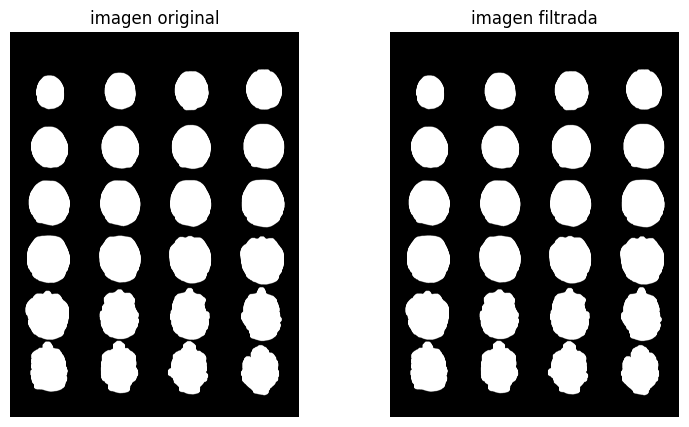

In [42]:
#recortar img7 
img8 = np.zeros((img.shape[0],img.shape[1]))
for i in range(0,len(minS)-1):
    img8[:,int(minS[i]):int(minS[i+1])] = img7[:,int(minS[i]):int(minS[i+1])]
plotear2(img7,img8)


In [86]:
CentroidesX = dfc.iloc[:,1]
CentroidesY = dfc.iloc[:,0]
#minimo valor de cada array 
minX = max(CentroidesX)
minY = max(CentroidesY)
print(minY,minX)
New = np.array(dfc.shape)

for j in range(0,len(CentroidesY)):
    if dfc.iloc[j,0] == minX & df.iloc[j,1]:


7036.31619042781 5274.3169756628795
(24, 2)


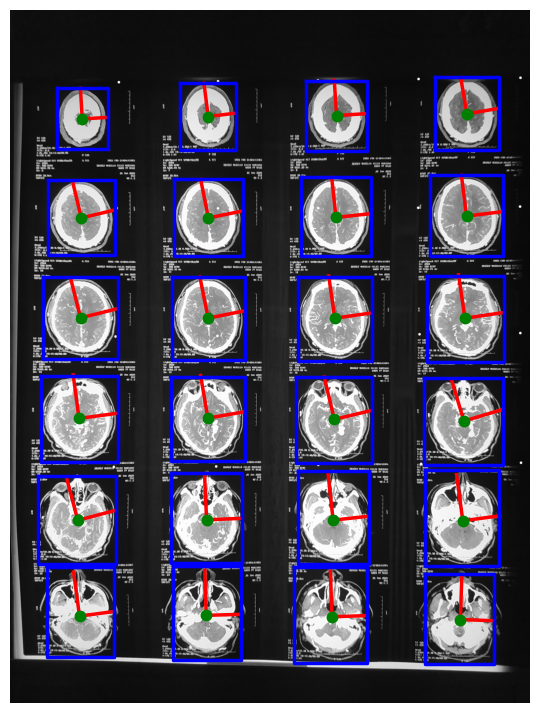

In [46]:
fig, ax = plt.subplots(figsize=(15, 9))
ax.imshow(img, cmap=plt.cm.gray)
for props in regions:
    y0, x0 = props.centroid
    orientation = props.orientation
    x1 = x0 + np.cos(orientation) * 0.5 * props.minor_axis_length
    y1 = y0 - np.sin(orientation) * 0.5 * props.minor_axis_length
    x2 = x0 - np.sin(orientation) * 0.5 * props.major_axis_length
    y2 = y0 - np.cos(orientation) * 0.5 * props.major_axis_length
    plt.plot((x0, x1), (y0, y1), '-r', linewidth=2.5)
    plt.plot((x0, x2), (y0, y2), '-r', linewidth=2.5)
    plt.plot(x0, y0, '.g', markersize=15)
    minr, minc, maxr, maxc = props.bbox
    bx = (minc, maxc, maxc, minc, minc)
    by = (minr, minr, maxr, maxr, minr)
    plt.plot(bx, by, '-b', linewidth=2.5)
    plt.imshow(img, cmap=plt.cm.gray)  
#plt.axis((0, 600, 600, 0))
plt.axis('off')
plt.show()

In [ ]:
#get average distance between centroids 
def distance():
    dist = []
    for i in range(0,len(CentroidesX)-1):
        dist.append(np.sqrt((CentroidesX[i+1]-CentroidesX[i])**2 + (CentroidesY[i+1]-CentroidesY[i])**2))
    return dist


In [ ]:
fig, ax = plt.subplots(figsize=(15, 9))
ax.imshow(img, cmap=plt.cm.gray)
for props in regions:
    y0, x0 = props.centroid
    orientation = props.orientation
    x1 = x0 + np.cos(orientation) * 0.5 * props.minor_axis_length
    y1 = y0 - np.sin(orientation) * 0.5 * props.minor_axis_length
    x2 = x0 - np.sin(orientation) * 0.5 * props.major_axis_length
    y2 = y0 - np.cos(orientation) * 0.5 * props.major_axis_length
    plt.plot((x0, x1), (y0, y1), '-r', linewidth=2.5)
    plt.plot((x0, x2), (y0, y2), '-r', linewidth=2.5)
    plt.plot(x0, y0, '.g', markersize=15)
    minr, minc, maxr, maxc = props.bbox
    bx = (minc, maxc, maxc, minc, minc)
    by = (minr, minr, maxr, maxr, minr)
    plt.plot(bx, by, '-b', linewidth=2.5)
    plt.imshow(img, cmap=plt.cm.gray)  
#plt.axis((0, 600, 600, 0))
    plt.axis('off')
    plt.show()

1


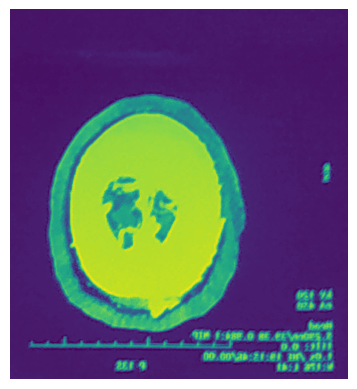

2


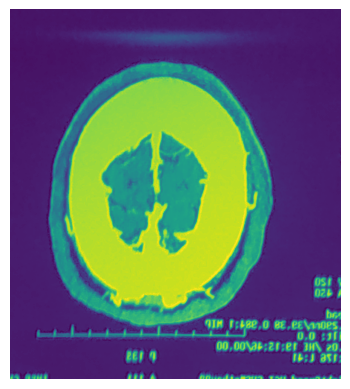

3


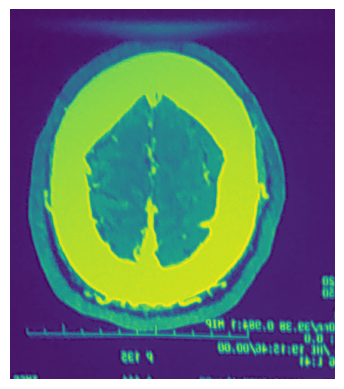

4


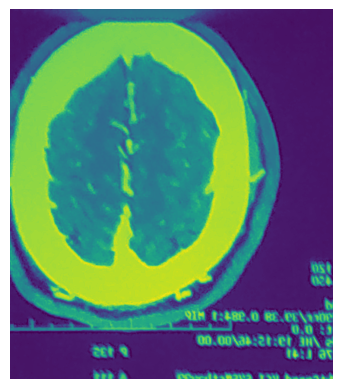

5


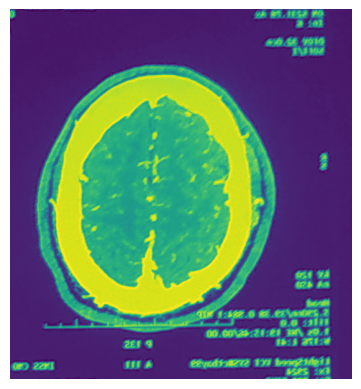

6


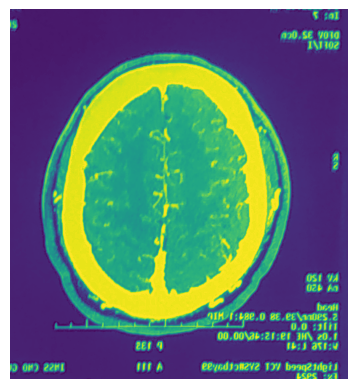

7


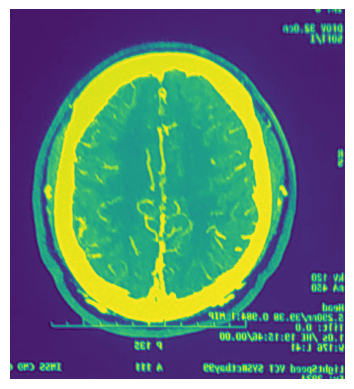

8


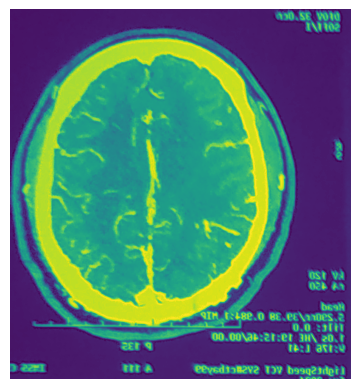

9


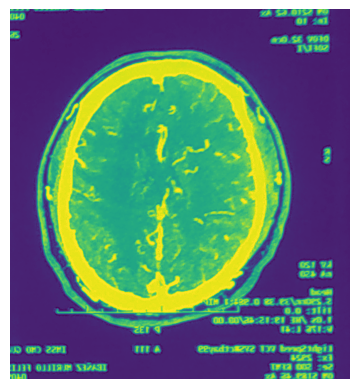

10


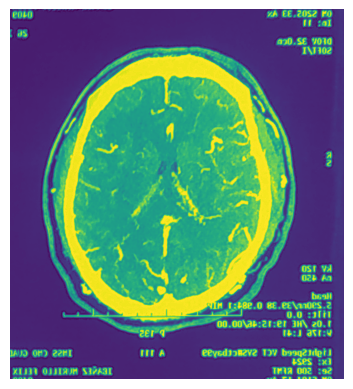

11


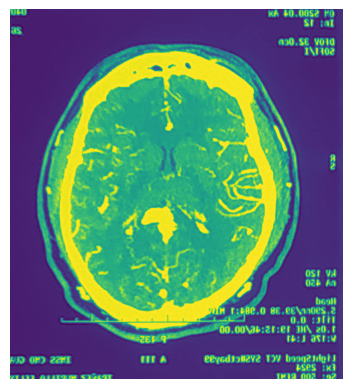

12


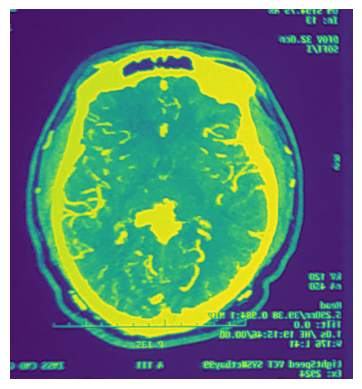

13


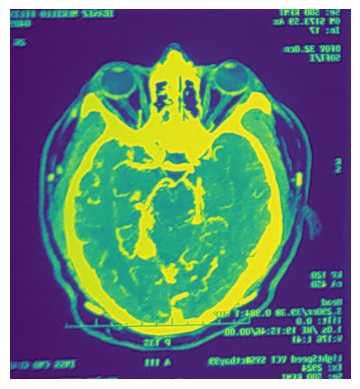

14


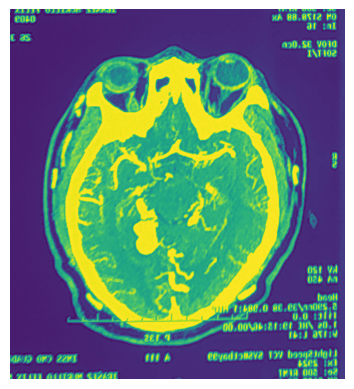

15


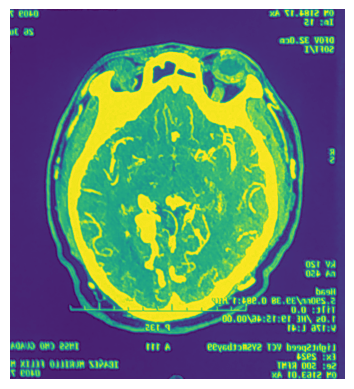

16


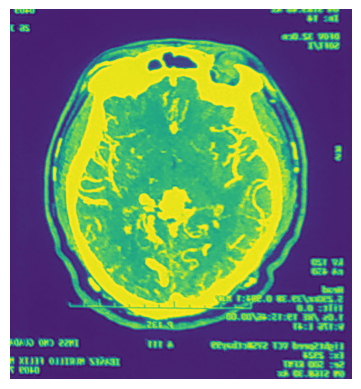

17


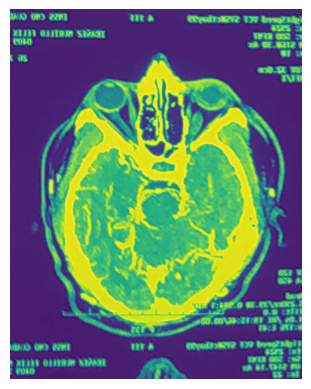

18


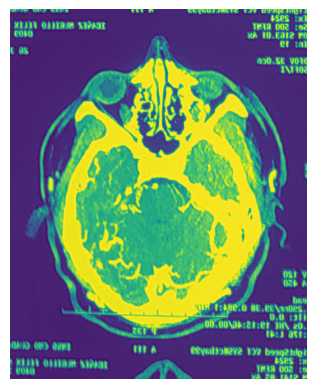

19


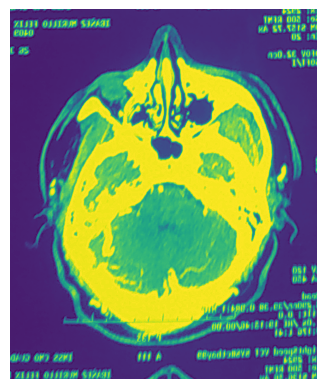

20


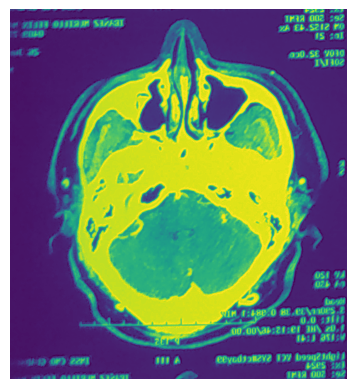

21


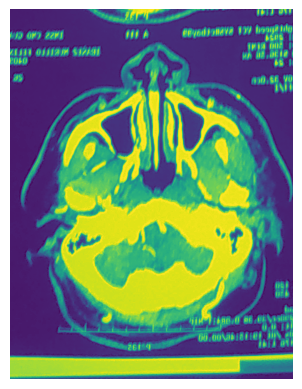

22


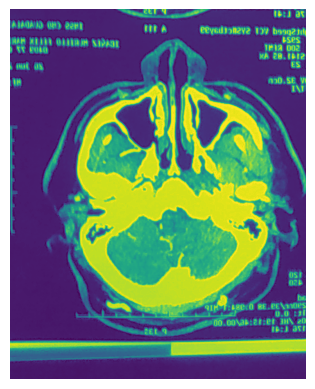

23


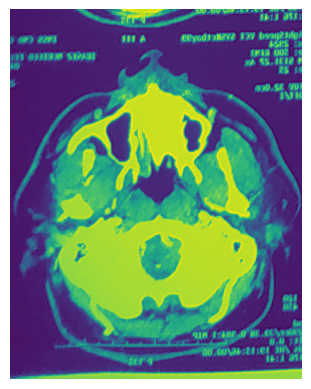

24


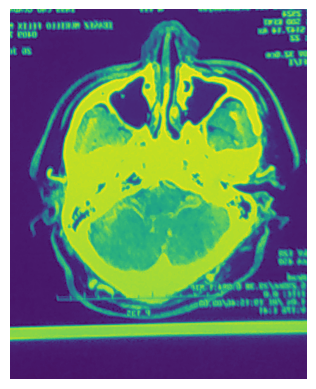

In [43]:
#recortar imagenes 
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
#cortar imagenes apartir de props.bbox "E:\Septimo semestre\Servicio\digitalizador\imgCut"
def cortarImagenes(img,regions):
    ruta = "E:\Septimo semestre\Servicio\digitalizador\imgCut\Img"
    n = 1
    for props in regions:
        minr, minc, maxr, maxc = props.bbox
        crop_img = img[minr-100:maxr+100, minc-100:maxc+100]
        #crop_img = cv.flip(crop_img, 1)
        cv.imwrite(ruta+str(n)+".jpg",crop_img)
        print(n)
        n = n+1
        plt.imshow(crop_img)
        plt.axis('off')
        plt.show()
cortarImagenes(img,regions)

In [44]:
from skimage.measure import label, regionprops, regionprops_table
props = regionprops_table(img7, properties=('centroid',
                                                 'orientation',
                                                 'axis_major_length',
                                                 'axis_minor_length'))
pd.DataFrame(props) 

,centroid-0,centroid-1,orientation,axis_major_length,axis_minor_length
0,4345.60598,3073.495954,-0.213903,7592.07136,6638.391103


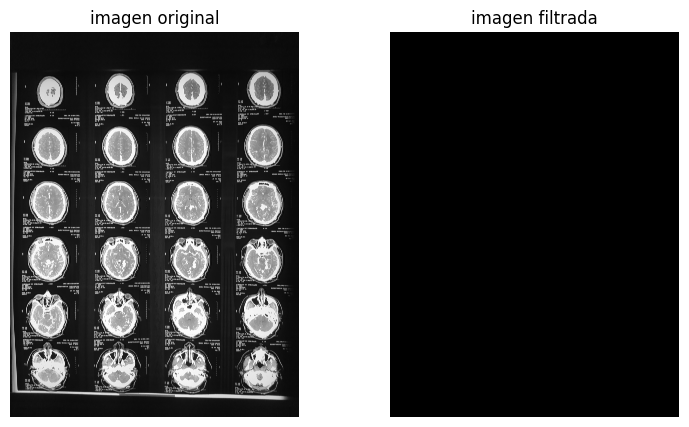

In [43]:
#img = mosaicImage[:,:,0].astype('uint8')
contours, _ = cv.findContours(img7.copy(), cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
mask = np.zeros(img.shape, np.uint8)
mask1 = cv.drawContours(mask, contours, -1, (0,255,0),1)
plotear2(img,mask1)

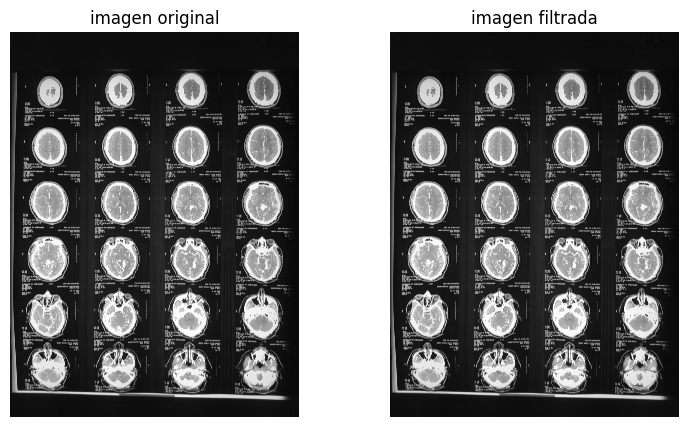

In [40]:
# obtener los contornos
contours, _ = cv.findContours(img7, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

# dibujar los contornos
cv.drawContours(img, contours, -1, (0, 0, 255), 2, cv.LINE_AA)
for c in contours:
    area = cv.contourArea(c)
    if area > 10000 and area < 700000:
        (x, y, w, h) = cv.boundingRect(c)
        imgR =cv.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 1, cv.LINE_AA)
        #get image 
        
plotear2(img,imgR)

In [ ]:



for c in contours:
    area = cv.contourArea(c)
    if area > 1000 and area < 700000:
        cv.drawContours(img, [c], 0, (0, 255, 0), 2, cv.LINE_AA)

#rescale image 
scale_percent =  10 # percent of original size
width = int(img.shape[1] * scale_percent / 100)
height = int(img.shape[0] * scale_percent / 100)
dim = (width, height)
# resize image
resized = cv.resize(img, dim, interpolation = cv.INTER_AREA)
plotear2(img,img7)
#cv.imshow('contornos', img)
#cv.imshow('umbral', img7)

#cv.waitKey(0)

In [22]:
#filtramos por tamaño
nb_components, output, stats, centroids = cv.connectedComponentsWithStats(th1, connectivity=8)

sizes = stats[1:, -1]; nb_components = nb_components - 1

min_size = 100000 # Este tamaño es variable, yo he puesto 1000 
max_size = 700000 
img2 = np.zeros((output.shape))

for i in range(0, nb_components):
    if max_size >= sizes[i] >= min_size :
        img2[output == i + 1] = 255

IndexError: boolean index did not match indexed array along dimension 0; dimension is 25 but corresponding boolean dimension is 1075

In [26]:
src = cv.imread(r"E:\Septimo semestre\Procesamiento de imagenes\cerebros.jpg")

gray = cv.cvtColor(src, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 3)

t, dst = cv.threshold(gray, 0, 255, cv.THRESH_BINARY | cv.THRESH_TRIANGLE)

In [29]:
# obtener los contornos
contours,hierachy = cv.findContours(dst, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

# dibujar los contornos
cv.drawContours(src, contours, -1, (0, 0, 255), 2, cv.LINE_AA)

array([[[14, 14, 30],
        [14, 14, 30],
        [14, 15, 29],
        ...,
        [ 6,  9, 13],
        [ 6,  9, 13],
        [ 6,  9, 13]],

       [[14, 14, 30],
        [14, 14, 30],
        [14, 15, 29],
        ...,
        [ 6,  9, 13],
        [ 6,  9, 13],
        [ 6,  9, 13]],

       [[14, 15, 29],
        [14, 15, 29],
        [14, 15, 29],
        ...,
        [ 6,  9, 13],
        [ 6,  9, 13],
        [ 6,  9, 13]],

       ...,

       [[ 9, 10, 14],
        [ 9, 10, 14],
        [ 9, 10, 14],
        ...,
        [ 8, 12, 13],
        [ 8, 12, 13],
        [ 9, 13, 14]],

       [[ 8,  9, 13],
        [ 8,  9, 13],
        [ 8,  9, 13],
        ...,
        [ 7, 11, 12],
        [ 7, 12, 13],
        [ 8, 13, 14]],

       [[ 8,  9, 13],
        [ 8,  9, 13],
        [ 8,  9, 13],
        ...,
        [ 7, 11, 12],
        [ 7, 12, 13],
        [ 8, 13, 14]]], dtype=uint8)